In [1]:
%matplotlib notebook
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation

import matplotlib
import matplotlib.colors as colors
from matplotlib.colors import ListedColormap

import scipy.fft
import scipy.io.wavfile
import scipy.signal
import os, sys
import time

import copy

import tqdm

import librosa
import audioread

import warnings

In [2]:
%matplotlib notebook
import radioamnion

import numpy as np

import matplotlib.pyplot as plt

# Load wav file, do the LED trasformation and save it as a csv-file

In [3]:
#f_name = '~/Downloads/radioamnion/LateralWaters.wav'
#f_name = '~/Downloads/radioamnion/pacific2.wav'
f_name = '~/Downloads/radioamnion/Hertz__Four_Aquatic_Mirroring_Devices.wav'
f_name = '~/Downloads/radioamnion/Radio Amnion_Andrea Zarza.wav'
#f_name = '~/Downloads/radioamnion/holohedral-1.wav'
f_name = '~/Downloads/radioamnion/DarkMorph_Full.mp3'
f_name = '~/Downloads/radioamnion/watery_thoughts.mp3'
f_name = '~/Downloads/radioamnion/PlasmaticaFantastica_RadioAmnion_220108.wav'
f_name = '~/Downloads/radioamnion/TAL_600HZ_ozone_master130322.wav'

audio_led = radioamnion.Audio2LED(f_name)
print(f'Resulting fps: {audio_led.fps:.2f} frames/s')

audio_led.save_to_csv()

Resulting fps: 23.44 frames/s


'/Users/kilian/Downloads/radioamnion/TAL_600HZ_ozone_master130322.csv'

# Plot the waveform and frequency space for some chunks

## Select some chunks

In [4]:
chunks_i = np.linspace(100, audio_led.f_data.shape[-2]-100,20, dtype=int)

## Plot the waveform for different chunks

<IPython.core.display.Javascript object>


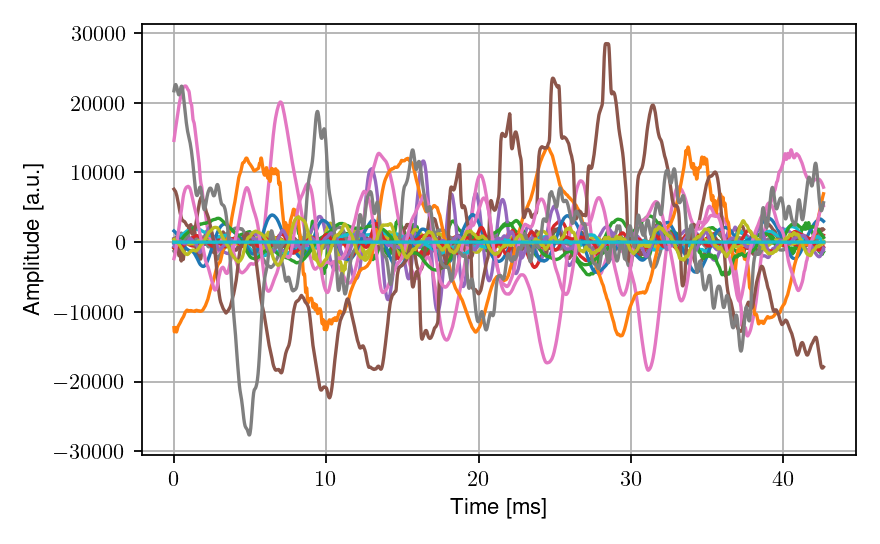

In [5]:
plt.figure()
for i in chunks_i:
    time_plot = audio_led.time_chunked[i] - audio_led.time_chunked[i,0] # relative time per chunk
    time_plot *= 1e3 # s -> ms
    plt.plot(time_plot, audio_led.data_chunked[audio_led.selected_channel ,i,:],
             label=f'{np.average(audio_led.time_chunked[i]):6.2f} s')
#plt.yscale('log')

plt.xlabel('Time [ms]')
plt.ylabel('Amplitude [a.u.]')

#plt.legend()
plt.grid()
plt.tight_layout()

## Plot frequency space

<IPython.core.display.Javascript object>


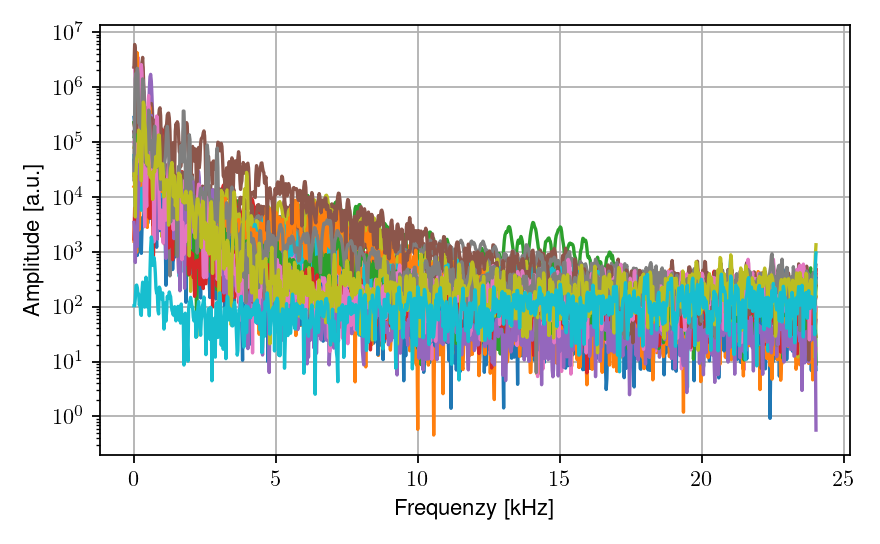

In [6]:
plt.figure()
for i in chunks_i:
    plt.plot(audio_led.frequency_arr / 1e3, # Hz -> kHz
             np.abs(audio_led.f_data[audio_led.selected_channel,i,:]),
             label=f'{np.average(audio_led.time_chunked[i]):6.2f} s')
    
plt.yscale('log')

plt.xlabel('Frequenzy [kHz]')
plt.ylabel('Amplitude [a.u.]')

#plt.legend()
plt.grid()
plt.tight_layout()

# Plot amplitude for some frequencies bundles

The frequencies are bundled in chunks with a log-sacel width and position. The amplitudes of this chunks are sumed up and plotted. The displayed frequency if the middle frequency (linear) of the chunks.

num_index : number of chunks <br>
min_frequency : minimum frequency of the first chunk <br>
max_frequency : max frequency of the last chunk <br>

<IPython.core.display.Javascript object>


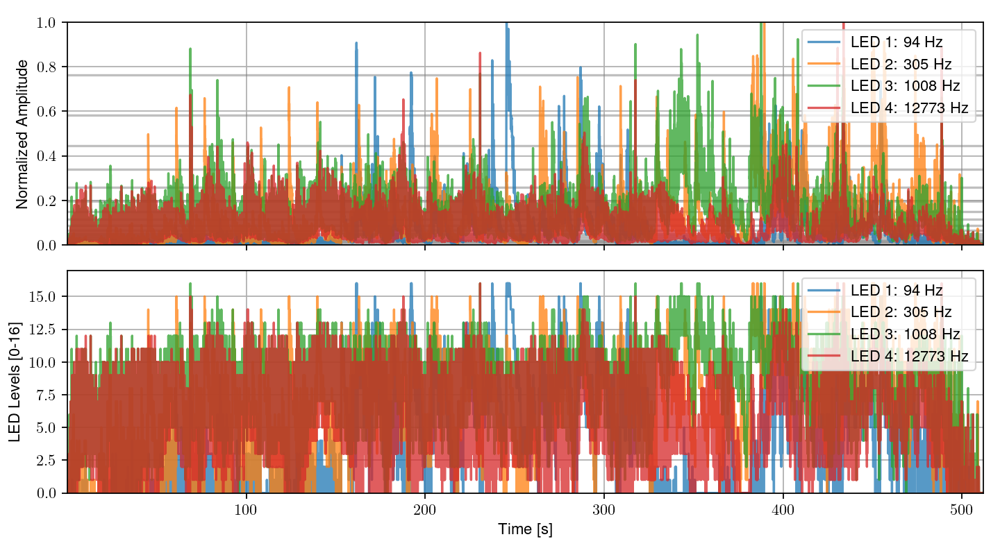

In [7]:
alpha=.75

fig, ax = plt.subplots(sharex=True, nrows=2, squeeze=False, figsize=[9,5])
ax = ax.flatten()

time_x = np.average(audio_led.time_chunked,axis=-1)

for i in audio_led.led_levels:
    ax[0].plot([time_x.min(), time_x.max()], [i[0]]*2, alpha=.5, color='gray')
               
for i, (i_min, i_max) in enumerate(audio_led.frequency_boarder_index):
    ax[0].plot(time_x,
               audio_led.freq_channel_amp_norm[audio_led.selected_channel, i],
               label=f'LED {i+1}: {audio_led.frequency_arr[(i_min+i_max)//2]:.0f} Hz',
               alpha=alpha)
    
    ax[1].plot(time_x, 
               audio_led.led_channel_levels[2, i],
               label=f'LED {i+1}: {audio_led.frequency_arr[(i_min+i_max)//2]:.0f} Hz',
               alpha=alpha)

plt.xlabel('Time [s]')

for ax_i in ax:
    ax_i.legend(loc=1)
    ax_i.grid()
    
ax[0].set_ylabel('Normalized Amplitude')
ax[1].set_ylabel('LED Levels [0-16]')

ax[0].set_ylim(0,1)
ax[1].set_ylim(0, ax[1].dataLim.y1+1)
    
ax[-1].set_xlim(ax[-1].dataLim.x0, ax[-1].dataLim.x1)
#plt.yscale('log')
plt.tight_layout()

# Load the levels to a csv file

In [8]:
led_time, led_channel_levels = radioamnion.load_csv('/Users/kilian/Downloads/Ourano_Amnion_2021_mixdown.csv')

In [9]:
f'{f_name.split(".",1)[0]}_log2_5kHz.mp4'



'~/Downloads/radioamnion/TAL_600HZ_ozone_master130322_log2_5kHz.mp4'

# Create a primitive visualisation

<IPython.core.display.Javascript object>


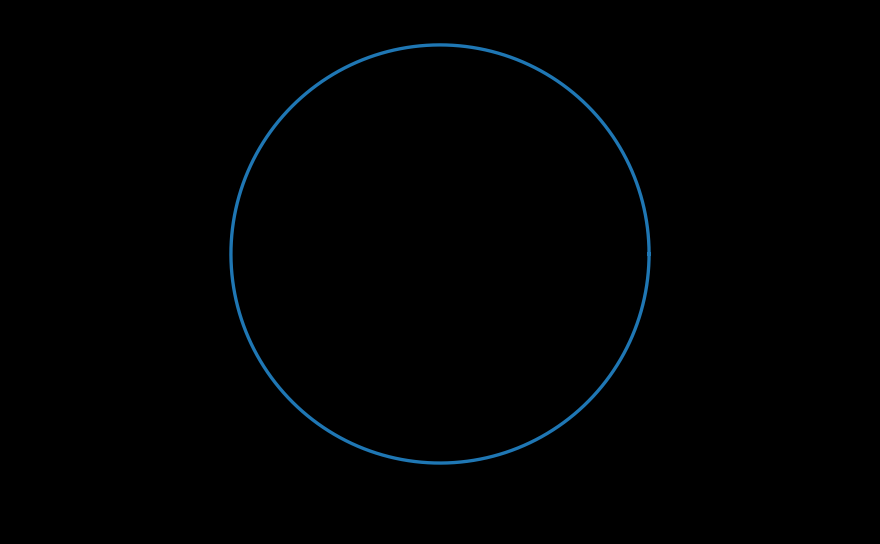

100%|██████████| 28644/28644 [19:45<00:00, 24.16it/s] 
Moviepy - Building video /Users/kilian/Downloads/holohedral-1_log2_5kHz_audio.mp4.
MoviePy - Writing audio in holohedral-1_log2_5kHz_audioTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video /Users/kilian/Downloads/holohedral-1_log2_5kHz_audio.mp4



Moviepy - Done !
Moviepy - video ready /Users/kilian/Downloads/holohedral-1_log2_5kHz_audio.mp4


In [21]:
visualizer = radioamnion.LEDVisualizer()
visualizer.cal_animation(led_channel_levels=audio_led.led_channel_levels[audio_led.selected_channel],
                         fps=audio_led.fps,
                         file_name=f'{audio_led.file_name.split(".",1)[0]}_log2_5kHz.mp4')

visualizer.add_music(f'{audio_led.file_name.split(".",1)[0]}_log2_5kHz.mp4', audio_led.file_name)

In [ ]:
# import moviepy.editor as mpe
# import shutil

# audio_led = radioamnion.Audio2LED(f_name)
# print(f'Resulting fps: {audio_led.fps:.2f} frames/s')


# audio_led.cal_led_levels(min_frequency=40, 
#                         max_frequency=5000.0, 
#                         index_log=True, 
#                         alpha_log=True)

# my_clip = mpe.VideoFileClip('LED_log2_5kHz.mp4')
# audio_background = mpe.AudioFileClip(audio_led.file_name)
# #final_audio = mpe.CompositeAudioClip([my_clip.audio, audio_background])
# final_clip = my_clip.set_audio(audio_background)
# final_clip.write_videofile('LED_log2_5kHz_with_music.mp4', threads=6)

# 3D plot

In [10]:
fourier_visualizer = radioamnion.FourierSpaceVisualizer()
fourier_visualizer.plot_3d(led_converter=audio_led,log=False, n_trans=0)

for facecolor_i in ['black', 'white']:
    for log_i in [True, False]:
        for ntrans_i in [0, 64, 128]:
            fourier_visualizer.plot_3d(led_converter=audio_led,
                                       log=log_i,
                                       facecolor=facecolor_i,
                                       n_trans=ntrans_i, 
                                       t_steps=12, 
                                       f_steps=20)
            #plt.close()
            

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

KeyboardInterrupt: 

In [ ]:
for facecolor_i in ['black', 'white'][:1]:
    for log_i in [True, False][:1]:
        for ntrans_i in [0, 64, 128]:
            fourier_visualizer.animate_3d(led_converter=audio_led,
                                          file_name=audio_led.file_name.split(".",1)[0],
                                          log=log_i,
                                          facecolor=facecolor_i,
                                          steps=180,
                                          fps=20,
                                          n_trans=ntrans_i,
                                          t_steps=12, f_steps=20)
            plt.close()

# Plotly plots

In [11]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.spatial.transform import Rotation as R
import numpy as np

import healpy as hp

class ColorscaleModifier:
    @staticmethod
    def colorscale_to_array(cscale: str):
        colorscale = px.colors.get_colorscale(cscale)

        colorscale_arr = np.zeros((len(colorscale), 5))  # [[value, red, green, blue, alpha]]
        for i, color_i in enumerate(colorscale):
            if isinstance(color_i[1], str) and color_i[1].startswith('#'):
                colorscale_arr[i] = np.array([color_i[0], *px.colors.hex_to_rgb(color_i[1]), 1.])

            elif isinstance(color_i[1], str) and color_i[1].startswith('rgb('):
                colorscale_arr[i] = np.array([color_i[0],
                                              *ColorscaleModifier.rgb_to_tuple(color_i[1]),
                                              1.])

            elif isinstance(color_i[1], str) and color_i[1].startswith('rgba('):
                colorscale_arr[i] = np.array([color_i[0],
                                              *ColorscaleModifierrgba_to_tuple(color_i[1])])

            elif isinstance(color_i[1], tuple):
                colorscale_arr[i] = np.array([color_i[0], *color_i[1], 1.])

        return colorscale_arr

    @staticmethod
    def array_to_colorscale(colorscale_arr):
        return [[i[0], f'rgba({i[1]:.0f},{i[2]:.0f},{i[3]:.0f},{i[4]})'] for i in colorscale_arr]

    @staticmethod
    def rgb_to_tuple(rgb):
        rgb = rgb.replace('rgb(','').replace(')','')
        return tuple(map(int, rgb.split(',')))

    @staticmethod
    def rgba_to_tuple(rgb):
        rgb = rgb.replace('rgba(','').replace(')','')
        return tuple(map(int, rgb.split(',')))

    @staticmethod
    def add_color_below(colorscale_arr, color_rgba):
        colorscale_arr[0, 0] += 1e-2  # lower values seems to not work if the len(colorscale) is too big
        return np.append([[0.0, *color_rgba]], colorscale_arr, axis=0)

    @staticmethod
    def add_color_above(colorscale_arr, color_rgba):
        colorscale_arr[-1, 0] -= 1e-2 # lower values seems to not work if the len(colorscale) is too big
        return np.append(colorscale_arr, [[1.0, *color_rgba]], axis=0)
    
    @staticmethod
    def fade_alpha(colorscale_arr, inverse=False, alpha_start=0., alpha_stop=1.):
        if inverse:
            alpha_start, alpha_stop = alpha_stop, alpha_start
        colorscale_arr[:, -1] = np.linspace(alpha_start, alpha_stop, colorscale_arr.shape[0])
        return colorscale_arr
    
    @staticmethod
    def interp(colorscale_arr, n=10):
        x = np.linspace(0,1,n)
        colorscale_arr = np.array([x,
                                   np.interp(x, colorscale_arr[:,0], colorscale_arr[:,1]),
                                   np.interp(x, colorscale_arr[:,0], colorscale_arr[:,2]),
                                   np.interp(x, colorscale_arr[:,0], colorscale_arr[:,3]),
                                   np.interp(x, colorscale_arr[:,0], colorscale_arr[:,4]),
                                  ]).T
        return colorscale_arr
        

class Colorscale(ColorscaleModifier):
    def __init__(self, cscale=None):
        if cscale is None:
            self.cscale = None
            self.colorscale_arr = None
        else:
            self.cscale = cscale
            self.colorscale_arr = self.colorscale_to_array(cscale)
        
    @property
    def colorscale(self,):
        return self.array_to_colorscale(self.colorscale_arr)
    
    def add_color_below(self, color_rgba):
        self.colorscale_arr = ColorscaleModifier.add_color_below(self.colorscale_arr, color_rgba)
        return self

    def add_color_above(self, color_rgba):
        self.colorscale_arr = ColorscaleModifier.add_color_above(self.colorscale_arr, color_rgba)
        return self
    
    def fade_alpha(self, inverse=False, alpha_start=0., alpha_stop=1.):
        self.colorscale_arr = ColorscaleModifier.fade_alpha(self.colorscale_arr,
                                             inverse=inverse,
                                             alpha_start=alpha_start, alpha_stop=alpha_stop)
        return self
    
    def interp(self, n=10):
        self.colorscale_arr = ColorscaleModifier.interp(self.colorscale_arr,n=n)
        return self


def test(cscale):
    color_mod = Colorscale(cscale)
    print(color_mod.colorscale_arr)
    
    color_mod.fade_alpha()
    print(color_mod.colorscale_arr)
    
    color_mod.add_color_below((0,0,0,0))
    print(color_mod.colorscale_arr[:2])
    
    color_mod.add_color_above((1,1,1,1))
    print(color_mod.colorscale_arr[-2:])
    
    print(color_mod.colorscale)
    
# test('Blues_r')
# test('Viridis_r')

In [12]:
color_mod = Colorscale('Viridis_r')
# color_mod.fade_alpha()
#color_mod.add_color_below((0,0,0,0))

# color_mod.colorscale_arr[:,-1] = 1
# color_mod.colorscale_arr[0,-1] = 0
color_mod.colorscale_arr

array([[0.00000000e+00, 2.53000000e+02, 2.31000000e+02, 3.70000000e+01,
        1.00000000e+00],
       [1.11111111e-01, 1.81000000e+02, 2.22000000e+02, 4.30000000e+01,
        1.00000000e+00],
       [2.22222222e-01, 1.10000000e+02, 2.06000000e+02, 8.80000000e+01,
        1.00000000e+00],
       [3.33333333e-01, 5.30000000e+01, 1.83000000e+02, 1.21000000e+02,
        1.00000000e+00],
       [4.44444444e-01, 3.10000000e+01, 1.58000000e+02, 1.37000000e+02,
        1.00000000e+00],
       [5.55555556e-01, 3.80000000e+01, 1.30000000e+02, 1.42000000e+02,
        1.00000000e+00],
       [6.66666667e-01, 4.90000000e+01, 1.04000000e+02, 1.42000000e+02,
        1.00000000e+00],
       [7.77777778e-01, 6.20000000e+01, 7.30000000e+01, 1.37000000e+02,
        1.00000000e+00],
       [8.88888889e-01, 7.20000000e+01, 4.00000000e+01, 1.20000000e+02,
        1.00000000e+00],
       [1.00000000e+00, 6.80000000e+01, 1.00000000e+00, 8.40000000e+01,
        1.00000000e+00]])

In [13]:
fourier_visualizer = radioamnion.FourierSpaceVisualizer()
xx, yy, zz = fourier_visualizer.create_2d_arrays(led_converter=audio_led,
                                       log=True,
                                       t_steps=1, 
                                       f_steps=1)

x = xx.flatten()
y = yy.flatten()
z = zz.flatten()

In [14]:
steps_x, steps_y = 30, 10
core = np.ones((steps_x, steps_y))
core /= np.sum(core)

zz_conv = scipy.signal.convolve2d(zz, core, mode='valid')

x_conv = np.convolve(xx[0,:]/1e3, np.ones(steps_y)/steps_y,mode='valid')
y_conv = np.convolve(yy[:,0], np.ones(steps_y)/steps_y,mode='valid')
y_conv = (y_conv*1000.).astype('datetime64[ms]')

In [15]:
i = 50
width = 16*i
height = 9*i
width, height

(800, 450)

In [16]:
import plotly.graph_objects as go

color_mod = Colorscale(['Viridis_r', 'Viridis', 'Blues', 'Speed', 'Speed_r', 'Tempo', 'Tempo_r', 'Deep', 'Deep_r'][-2])  #'Viridis_r'
#color_mod.fade_alpha()
# color_mod.colorscale_arr[:,-1] = 1
# color_mod.colorscale_arr[0,-1] = 0
#color_mod.add_color_below((255,255,255,1))

#color_mod.fade_alpha()
#color_mod.add_color_below((0,0,0,0))


steps_x, steps_y = 30, 10
fig = go.Figure(layout_width=width,
                layout_height=height,
                data=[go.Surface(z=zz_conv[steps_x//4::steps_x//2,steps_y//4::steps_y//2],
                                 x=x_conv[steps_y//4::steps_y//2],
                                 y=y_conv[steps_x//4::steps_x//2],
                                 
                                 showscale=False,
                                 colorscale=color_mod.colorscale,
                                 yhoverformat="%H:%M:%S.%L",
                                 hovertemplate ='Time: %{y}<br>'
                                                'Frequency: %{x:.2f} kHz<br>'
                                                #'Amplitude: %{z:.2f}'
                                                '<extra></extra>',
                                )])

axis_dict = dict(showticklabels=False,
                 showgrid=False,
                 title='',
                 backgroundcolor="rgba(0,0,0,0)",
                 zerolinecolor="rgba(0,0,0,0)",
                 )

camera = dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1.75, y=0, z=1)
)

fig.update_layout(scene=dict(xaxis=axis_dict,yaxis=axis_dict,zaxis=axis_dict),
                  scene_camera=camera,
                  scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=2.5, z=1),
                  template="plotly_white",
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  margin=dict(l=0,r=0,b=0,t=0,pad=0),
                 )


file_name = os.path.basename(audio_led.file_name).rsplit(".",1)[0]
file_dir = os.path.join(os.path.dirname(audio_led.file_name), file_name)
if not os.path.exists(file_dir):
    os.makedirs(file_dir)
file_name_plot = os.path.join(file_dir, f'{file_name}-3d-{color_mod.cscale.lower()}')


fig.update_layout(scene_camera = dict(up=dict(x=0, y=0, z=1),
                                      center=dict(x=0, y=0, z=0),
                                      eye=dict(x=3.1, y=0, z=1)),
                 )
fig.write_image(f'{file_name_plot}.pdf', format='pdf', scale=10)
fig.update_layout(scene_camera = dict(up=dict(x=0, y=0, z=1),
                                      center=dict(x=0, y=0, z=0),
                                      eye=dict(x=3.1, y=0, z=1))
                 )
fig.write_image(f'{file_name_plot}.png', format='png', scale=10)

fig.update_layout(scene_camera = dict(up=dict(x=0, y=0, z=1),
                                      center=dict(x=0, y=0, z=0),
                                      eye=dict(x=2., y=0, z=1)),
                  width=None,
                  height=None,
                 )

fig.write_html(f'{file_name_plot}.html',
               auto_play=False,
               config={'displaylogo': False},
               include_plotlyjs='cdn', include_mathjax='cdn',
              )

fig.show(config={'displaylogo': False})

In [17]:
color_mod = Colorscale(['Viridis', 'Blues', 'Speed', 'Speed_r', 'Tempo', 'Tempo_r', 'Deep', 'Deep_r'][-1])  #'Viridis_r'
#color_mod.fade_alpha()
# color_mod.colorscale_arr[:,-1] = 1
# color_mod.colorscale_arr[0,-1] = 0
#color_mod.add_color_below((255,255,255,1))

#color_mod.fade_alpha()
#color_mod.add_color_below((255,255,255,1))
#color_mod.add_color_below((0,0,0,1))

n_colors = 15
zz_plot = zz_conv[steps_x//4::steps_x//2, steps_y//4::steps_y//2].T

fig = go.Figure(layout_width=width,
                layout_height=height,
                data=[go.Contour(x=y_conv[steps_x//4::steps_x//2],
                                 y=x_conv[steps_y//4::steps_y//2],
                                 z=zz_plot,
                                
                                 #line_smoothing=0.85,
                                 colorscale=color_mod.colorscale,
                                 showscale=False,
                                 contours=dict(start=zz_plot.min(), end=zz_plot.max(),
                                               size=(zz_plot.max()-zz_plot.min())/n_colors),
                                 xhoverformat="%H:%M:%S.%L",
                                 hovertemplate ='Time: %{x}<br>'
                                                'Frequency: %{y:.2f} kHz<br>'
                                                '<extra></extra>',
                                 #contours_coloring='heatmap', 
                                 contours_showlines=False,
                                 line_width=0,
                                ),
                     ])

axis_dict = dict(showticklabels=False,
                 showgrid=False,
                 title='',
                 linecolor="rgba(0,0,0,0)",
                 backgroundcolor="rgba(0,0,0,0)",
                 gridcolor="rgba(0,0,0,0)",
                 zerolinecolor="rgba(0,0,0,0)",
                 gridwidth = 0,
                 linewidth=0,
                 )
fig.update_layout(xaxis=dict(showticklabels=False),
                  yaxis=dict(showticklabels=False),
                  scene=dict(xaxis=axis_dict,yaxis=axis_dict,zaxis=axis_dict),
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  margin=dict(l=0,r=0,b=0,t=0,pad=0),
                 )


file_name = os.path.basename(audio_led.file_name).rsplit(".",1)[0]
file_dir = os.path.join(os.path.dirname(audio_led.file_name), file_name)
if not os.path.exists(file_dir):
    os.makedirs(file_dir)
file_name_plot = os.path.join(file_dir, f'{file_name}-2d-{color_mod.cscale.lower()}')
                              
fig.write_image(f'{file_name_plot}.pdf', format='pdf', scale=10)
fig.write_image(f'{file_name_plot}.png', format='png', scale=10)

fig.update_layout(width=None,height=None,)
fig.write_html(f'{file_name_plot}.html', auto_play=False,
               include_plotlyjs='cdn', include_mathjax='cdn')

fig.show()

In [18]:
# make figure
fig_dict = {
    "data": [],
    "layout": {},
    "frames": []
}

# fill in most of layout
updatemenus = [{"buttons": [{"args": [None,
                                      {"frame": {"duration": 2000,
                                                 "redraw": False},
                                       "fromcurrent": True, 
                                       "transition": {"duration": 300,
                                                      "easing": "quadratic-in-out"}}],
                             "label": "Play",
                             "method": "animate"
                            },
                            {"args": [[None], {"frame": {"duration": 0, "redraw": False},
                                               "mode": "immediate",
                                               "transition": {"duration": 0}}],
                             "label": "Pause",
                             "method": "animate"
                            }
                           ],
                "direction": "left",
                "pad": {"r": 10, "t": 87},
                "showactive": False,
                "type": "buttons",
                "x": 0.1,
                "xanchor": "right",
                "y": 0,
                "yanchor": "top"
               }
              ]
# fig_dict["layout"]["updatemenus"] = updatemenus

sliders_dict = {"active": 0,
                "yanchor": "top",
                "xanchor": "left",
                "currentvalue": {
                    #"font": {"size": 20},
                    "visible": True,
                    "xanchor": "right"
                },
                "transition": {"duration": 300, "easing": "cubic-in-out"},
                "pad": {"b": 10, "t": 50},
                "len": .9,
                "x": 0.05,
                "y": 0,
                "steps": []
               }

data = go.Contour(x=y_conv[steps_x//4::steps_x//2],
                  y=x_conv[steps_y//4::steps_y//2],
                  z=zz_plot,
              
                  #line_smoothing=0.85,
                  colorscale=color_mod.colorscale,
                  showscale=False,
                  contours=dict(start=zz_plot.min(), end=zz_plot.max(),
                                size=(zz_plot.max()-zz_plot.min())/n_colors),
                  xhoverformat="%H:%M:%S.%L",
                  hovertemplate ='Time: %{x}<br>'
                                 'Frequency: %{y:.2f} kHz<br>'
                                 '<extra></extra>',
                  #contours_coloring='heatmap', 
                  contours_showlines=False,
                  line_width=0,
                 )
fig_dict["data"].append(data)

# make frames
for color in ['Viridis', 'Viridis_r','Cividis', 'Cividis_r', 'Blues','Blues_r', 'Speed', 'Speed_r', 
              'Tempo', 'Tempo_r', 'Deep', 'Deep_r', 'Magma','Magma_r', 'Portland', 'Portland_r']:
    #data_i = copy.copy(data)
    #data_i.colorscale = color
    data_i = go.Contour(colorscale = color)
    frame = {"data": [data_i], "name": str(color)}
    fig_dict["frames"].append(frame)
    slider_step = {"args": [[color],
                            {"frame": {"duration": 300, "redraw": True},
                             "mode": "immediate",
                             "transition": {"duration": 300}}
                           ],
                   "label": color,
                   "method": "animate"}
    sliders_dict["steps"].append(slider_step)


fig_dict["layout"]["sliders"] = [sliders_dict]

fig = go.Figure(fig_dict)

axis_dict = dict(showticklabels=False,
                 showgrid=False,
                 title='',
                 linecolor="rgba(0,0,0,0)",
                 backgroundcolor="rgba(0,0,0,0)",
                 gridcolor="rgba(0,0,0,0)",
                 zerolinecolor="rgba(0,0,0,0)",
                 gridwidth = 0,
                 linewidth=0,
                 )
fig.update_layout(xaxis=dict(showticklabels=False),
                  yaxis=dict(showticklabels=False),
                  scene=dict(xaxis=axis_dict,yaxis=axis_dict,zaxis=axis_dict),
                  paper_bgcolor='rgba(0,0,0,0)',
                  plot_bgcolor='rgba(0,0,0,0)',
                  margin=dict(l=0,r=0,b=0,t=0,pad=0),
                 )


fig.write_html(f'{file_name_plot}_multi.html', auto_play=False,
               include_plotlyjs='cdn', include_mathjax='cdn')

fig.show()

In [18]:
os.path.dirname(audio_led.file_name), os.path.basename(audio_led.file_name)

('/Users/kilian/Downloads/radioamnion',
 'PlasmaticaFantastica_RadioAmnion_220108.wav')